### Laboratorium 6 - część badawcza

W pakiecie OpenCV wszystkie zadania związane z detekcją i opisem punktów kluczowych realizowane są przez zestaw specjalnych klas, dla których bazową jest `cv::Feature2D`. Jedną z wielu pochodnych tej klasy jest interesująca nas na zajęciach `cv::SIFT`, z której dokumentacją należy się zapoznać.  
Najważniejsze, co trzeba wiedzieć:
1. do konstrukcji obiektu SIFT służy metoda [`cv2.SIFT_create`](https://docs.opencv.org/4.x/d7/d60/classcv_1_1SIFT.html#ad337517bfdc068ae0ba0924ff1661131) - to do niej przekazujemy parametry detektora (w dokumentacji występuje jako `cv::SIFT::create`);
2. obsługujemy detektor przez interfejs `cv::Feature2D`, konkretnie metody [`detect`](https://docs.opencv.org/4.x/d0/d13/classcv_1_1Feature2D.html#aa4e9a7082ec61ebc108806704fbd7887) do detekcji punktów kluczowych oraz [`compute`](https://docs.opencv.org/4.x/d0/d13/classcv_1_1Feature2D.html#ab3cce8d56f4fc5e1d530b5931e1e8dc0) do obliczania ich deskryptorów (opcjonalnie `detectAndCompute`).

Schemat użycia:
```python
sift_instance = cv2.SIFT_create()
# 'image' powinno być obrazem jednokanałowym (jeśli nie, zostanie zastosowane cvtColor z flagą COLOR_BGR2GRAY)
keypoints = sift_instance.detect(image)
keypoints, descriptors = sift_instance.compute(image, keypoints)
```

`keypoints` jest listą obiektów specjalnego typu `cv2.KeyPoint`, która **jest modyfikowana** przez `SIFT::compute`!  
`descriptors` jest natomiast macierzą float32 o wymiarach NxK, gdzie N jest liczbą punktów kluczowych, a K jest liczbą obliczonych cech.

Warto również zapoznać się z funkcją [`cv2.drawKeypoints`](https://docs.opencv.org/4.x/d4/d5d/group__features2d__draw.html#ga5d2bafe8c1c45289bc3403a40fb88920) w kontekście prezentacji wyników. Zwróć uwagę na flagi sterujące rysowaniem - szczególnie użyteczna jest `cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS`.

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

#### Zadanie 1

Przetestuj wpływ podstawowych parametrów detektora SIFT (`contrastThreshold` i `edgeThreshold`) na uzyskiwane punkty kluczowe (liczność, lokalizacja, rozmiar), korzystając z obrazów `cells` i `lena`. Pamiętaj że ich działanie jest odwrotne (tzn. jeden odsiewa cechy "mniejsze niż", a drugi "większe niż").

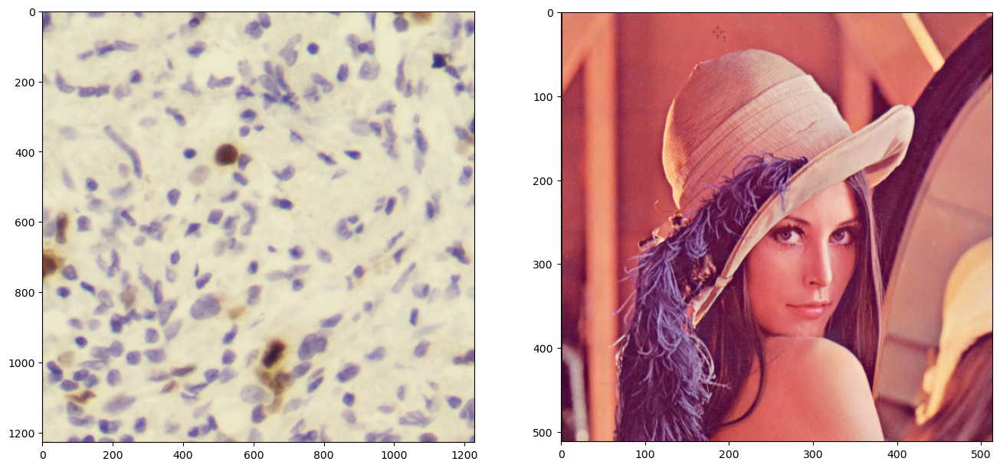

In [2]:
cells = cv2.imread('p1_0308_7.jpg')
lena = cv2.imread('Lena.jpg')
f, (a1, a2) = plt.subplots(1, 2, figsize=(16, 10))
a1.imshow(cells[..., ::-1]);
a2.imshow(lena[..., ::-1]);

# default values 

contrastThreshold = 0.04


edgeThreshold = 10

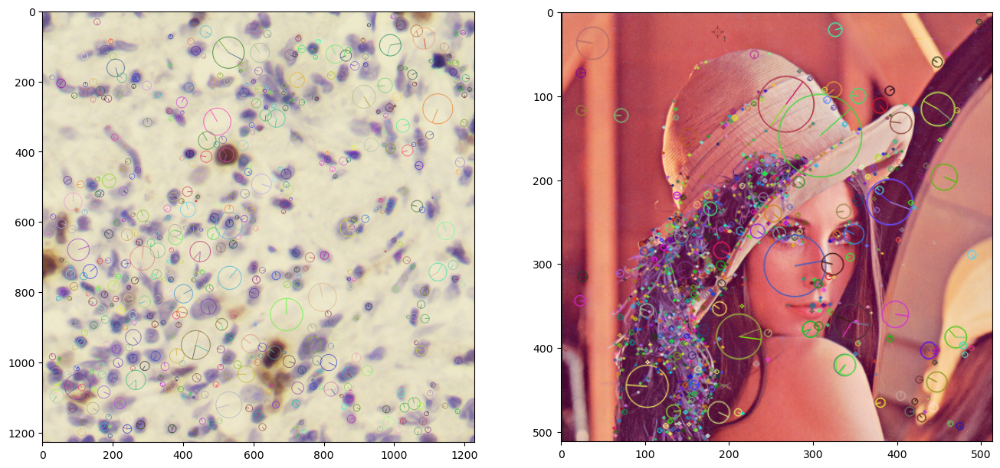

In [3]:
sift = cv2.SIFT_create()
keypoints, dsecriptors = sift.detectAndCompute(cells, None)
cells_with_keypoints = cv2.drawKeypoints(cells, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
keypoints, dsecriptors = sift.detectAndCompute(lena, None)
lena_with_keypoints = cv2.drawKeypoints(lena, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

f, (a1, a2) = plt.subplots(1, 2, figsize=(16, 10))
a1.imshow(cells_with_keypoints[..., ::-1]);
a2.imshow(lena_with_keypoints[..., ::-1]);

In [4]:
def test_image(img, contrast_treshold=0.04, edge_treshold=10):
    sift = cv2.SIFT_create(contrastThreshold=contrast_treshold, edgeThreshold=edge_treshold)
    keypoints, dsecriptors = sift.detectAndCompute(img, None)
    img_with_keypoints = cv2.drawKeypoints(img, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    return img_with_keypoints, keypoints

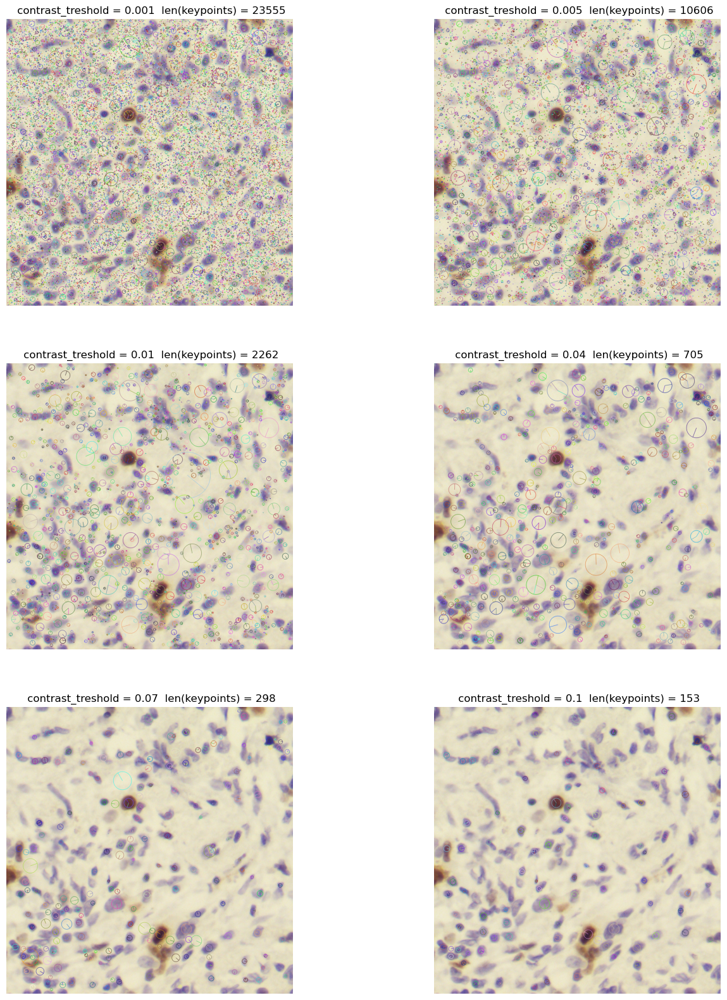

In [5]:
contrast_tresholds = [0.001, 0.005, 0.01, 0.04, 0.07, 0.1]

f, ax = plt.subplots(3, 2, figsize=(16, 20))
for i, contrast_treshold in enumerate(contrast_tresholds):
    img, keypoints = test_image(cells, contrast_treshold=contrast_treshold)
    img_with_keypoints = cv2.drawKeypoints(cells, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    ax[i // 2, i % 2].imshow(img_with_keypoints[..., ::-1]);
    ax[i // 2, i % 2].set_title(f'{ contrast_treshold = } { len(keypoints) = }');
    ax[i // 2, i % 2].axis('off');


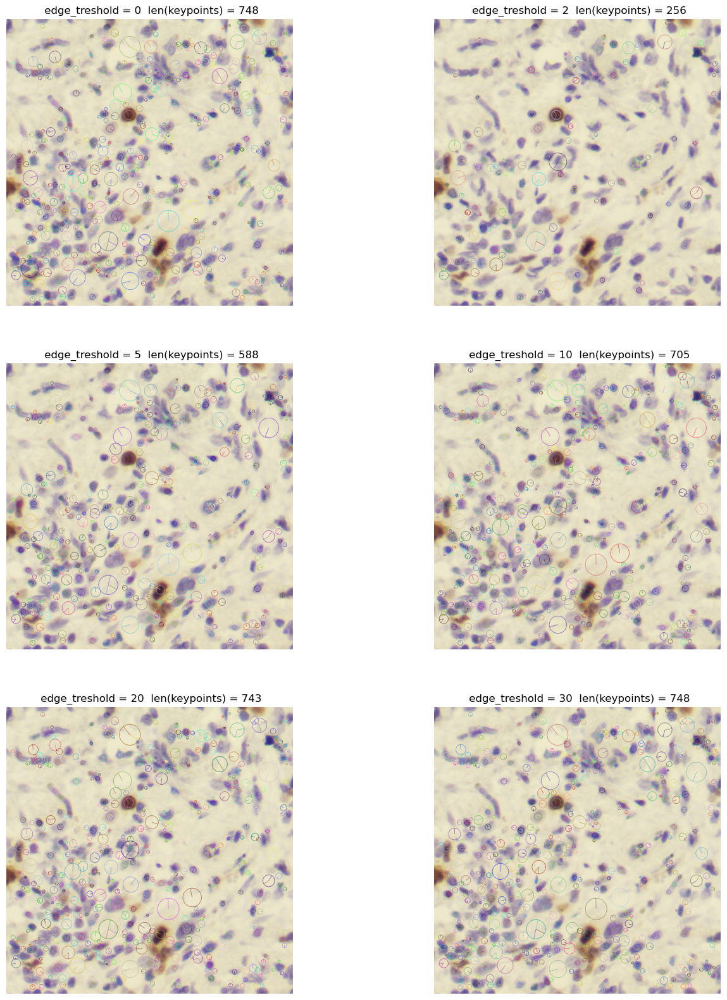

In [6]:
edge_tresholds = [0, 2, 5, 10, 20, 30]

f, ax = plt.subplots(3, 2, figsize=(16, 20))

for i, edge_treshold in enumerate(edge_tresholds):
    img, keypoints = test_image(cells, edge_treshold=edge_treshold)
    img_with_keypoints = cv2.drawKeypoints(cells, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    ax[i // 2, i % 2].imshow(img_with_keypoints[..., ::-1]);
    ax[i // 2, i % 2].set_title(f'{ edge_treshold = } { len(keypoints) = }');
    ax[i // 2, i % 2].axis('off');

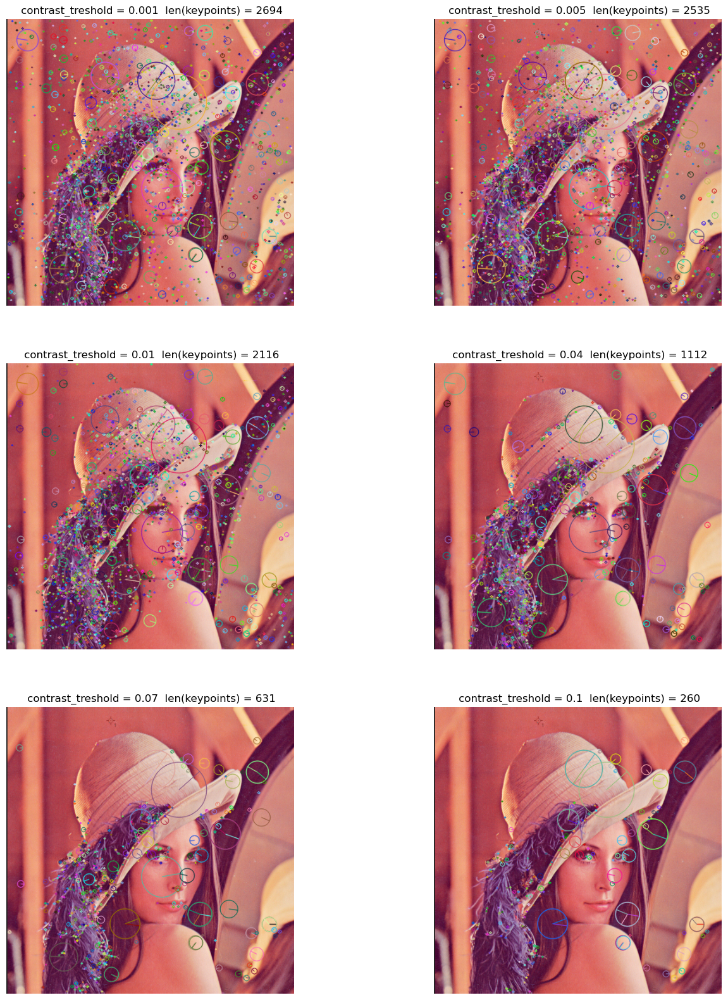

In [7]:
contrast_tresholds = [0.001, 0.005, 0.01, 0.04, 0.07, 0.1]

f, ax = plt.subplots(3, 2, figsize=(16, 20))
for i, contrast_treshold in enumerate(contrast_tresholds):
    img, keypoints = test_image(lena, contrast_treshold=contrast_treshold)
    img_with_keypoints = cv2.drawKeypoints(lena, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    ax[i // 2, i % 2].imshow(img_with_keypoints[..., ::-1]);
    ax[i // 2, i % 2].set_title(f'{ contrast_treshold = } { len(keypoints) = }');
    ax[i // 2, i % 2].axis('off');


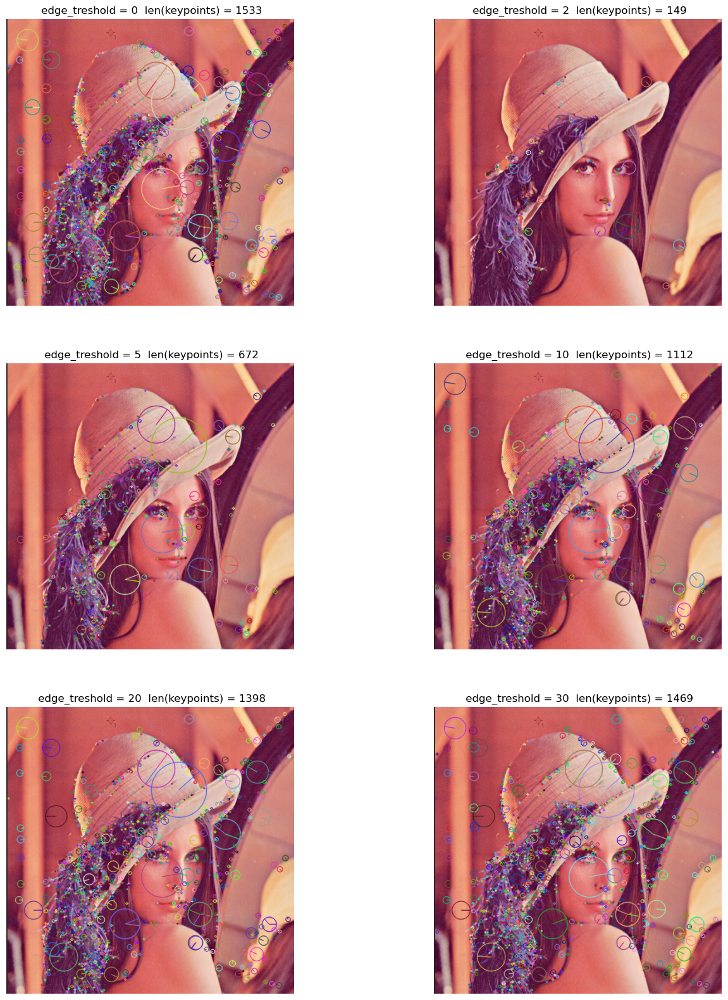

In [8]:
edge_tresholds = [0, 2, 5, 10, 20, 30]

f, ax = plt.subplots(3, 2, figsize=(16, 20))

for i, edge_treshold in enumerate(edge_tresholds):
    img, keypoints = test_image(lena, edge_treshold=edge_treshold)
    img_with_keypoints = cv2.drawKeypoints(lena, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    ax[i // 2, i % 2].imshow(img_with_keypoints[..., ::-1]);
    ax[i // 2, i % 2].set_title(f'{ edge_treshold = } { len(keypoints) = }');
    ax[i // 2, i % 2].axis('off');

- contrastThreshold kontroluje ogólną selektywność pod kątem kontrastu (filtruje cechy „zbyt słabe”).
- edgeThreshold filtruje punkty na dominujących krawędziach (filtruje cechy „zbyt wyraźne” w jednym wymiarze).

#### Zadanie 2

Detektor SIFT jest w teorii niezmienniczy względem translacji, rotacji czy zmiany skali. Przetestuj te własności w praktyce, sprawdzając stabilność punktów wykrywanych na obróconej i przeskalowanej wersji obrazów `cells` i `lena`. Dokonaj oceny wizualnie, sprawdzając zachowanie detektora dla kilku wybranych rotacji i skal (**nie** grid search).

_Co świadczy o stabilności i niezmienniczości detektora?_

In [9]:
def rotate(image, angle, scale=1.0):
    center = (image.shape[0] // 2, image.shape[1] // 2)
    rmat = cv2.getRotationMatrix2D(center, angle, scale)
    return cv2.warpAffine(image, rmat, (image.shape[0], image.shape[1]), flags=cv2.INTER_CUBIC)

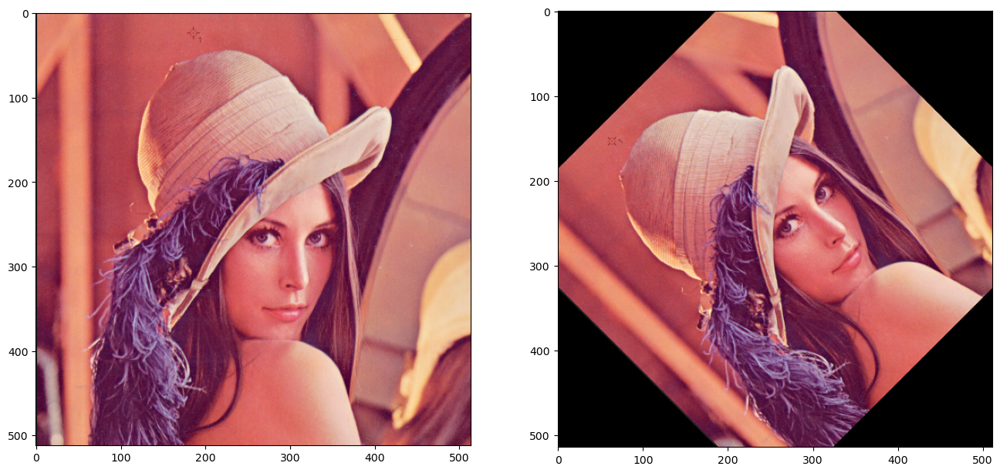

In [10]:
# przykład dla Leny, pamiętaj o cells!
lena_rot = rotate(lena, 45.0, scale=0.9)
f, (a1, a2) = plt.subplots(1, 2, figsize=(16, 10))
a1.imshow(lena[..., ::-1]);
a2.imshow(lena_rot[..., ::-1]);

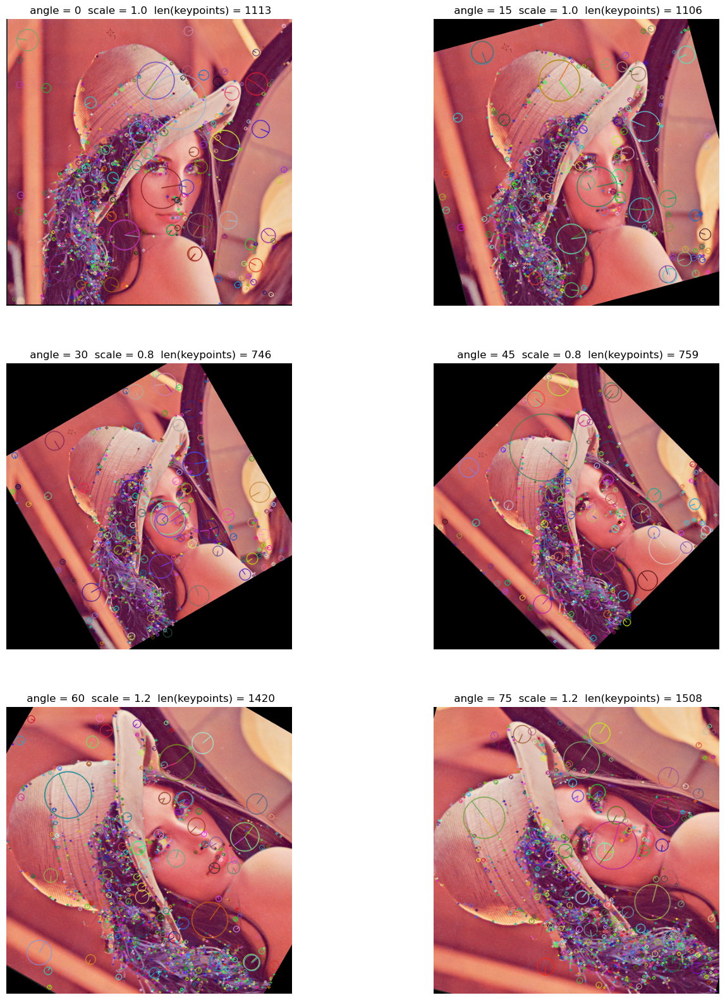

In [11]:

def test_image_rotation(img, angle, scale):
    img_rot = rotate(img, angle, scale)
    sift = cv2.SIFT_create()
    keypoints, dsecriptors = sift.detectAndCompute(img_rot, None)
    img_with_keypoints = cv2.drawKeypoints(img_rot, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    return img_with_keypoints, keypoints

angles_scale = [(0, 1.0), (15, 1.0), (30, 0.8), (45, 0.8), (60, 1.2), (75, 1.2)]


f, ax = plt.subplots(3, 2, figsize=(16, 20))
for i, (angle, scale) in enumerate(angles_scale):
    img, keypoints = test_image_rotation(lena, angle, scale)
    ax[i // 2, i % 2].imshow(img[..., ::-1]);
    ax[i // 2, i % 2].set_title(f'{ angle = } { scale = } { len(keypoints) = }');
    ax[i // 2, i % 2].axis('off');

#### Zadanie 3

Dane są obrazy `coke` i `table`. Wykorzystaj metodologię parowania punktów kluczowych do znalezienia wystąpienia puszki z Colą na stole. To zadanie jest podzielone na dwie części - czytaj dalej.

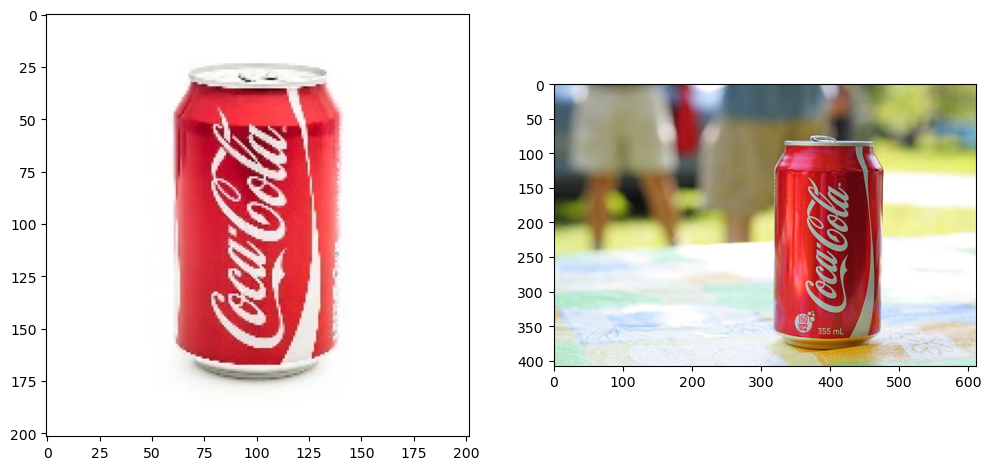

In [12]:
coke = cv2.imread('coke.jpg')
table = cv2.imread('coke-table.jpg')
f, (a1, a2) = plt.subplots(1, 2, figsize=(12,12))
a1.imshow(coke[..., ::-1]);
a2.imshow(table[..., ::-1]);

##### Zadanie 3a

Wykonaj detekcję punktów kluczowych i ich parowanie z użyciem dowolnego matchera. Wykonaj filtrację znalezionych par po dystansie - co obserwujesz, zmieniając próg?

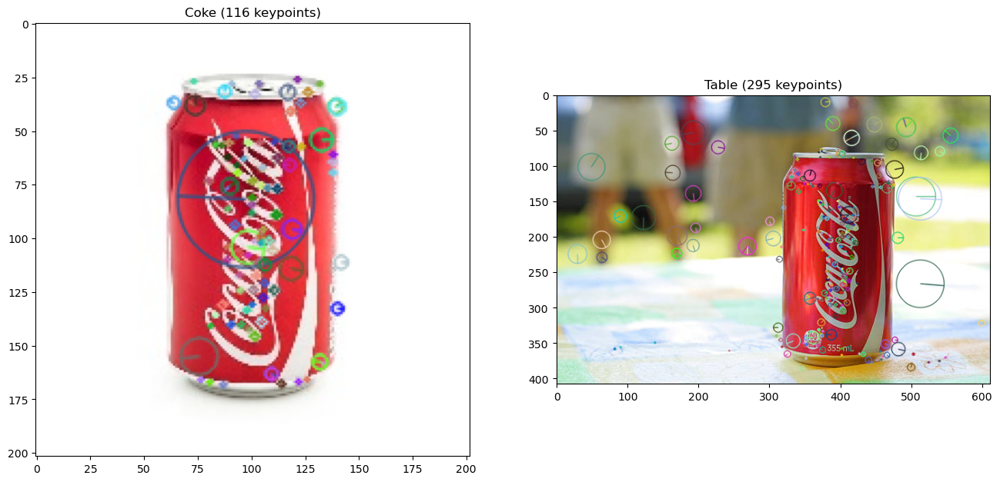

In [13]:
sift = cv2.SIFT_create(contrastThreshold=0.04, edgeThreshold=10)
k1, ds1 = sift.detectAndCompute(coke, None)
k2, ds2 = sift.detectAndCompute(table, None)

f, (a1, a2) = plt.subplots(1, 2, figsize=(16, 10))
a1.imshow(cv2.drawKeypoints(coke, k1, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)[..., ::-1]);
a2.imshow(cv2.drawKeypoints(table, k2, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)[..., ::-1]);

a1.set_title(f"Coke ({len(k1)} keypoints)");
a2.set_title(f"Table ({len(k2)} keypoints)");

plt.show()


(-0.5, 813.5, 407.5, -0.5)

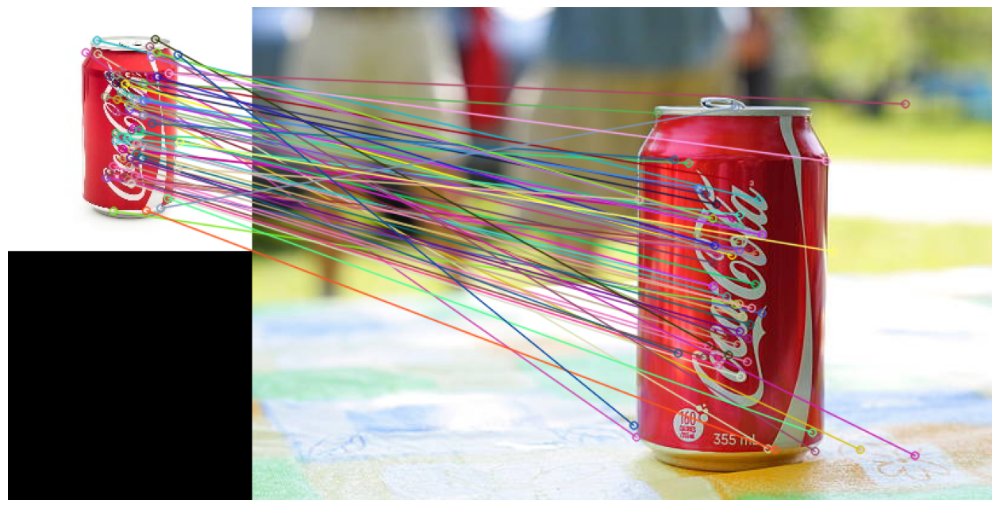

In [14]:
matcher = cv2.BFMatcher_create(cv2.NORM_L2, crossCheck=True)
matches = matcher.match(ds1, ds2)

img_matches = cv2.drawMatches(coke, k1, table, k2, matches, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(16, 10))

plt.imshow(img_matches[..., ::-1])
plt.axis('off')

In [15]:
distances = [m.distance for m in matches]
np.mean(distances), np.std(distances)

(267.9552254310021, 81.90621536032963)

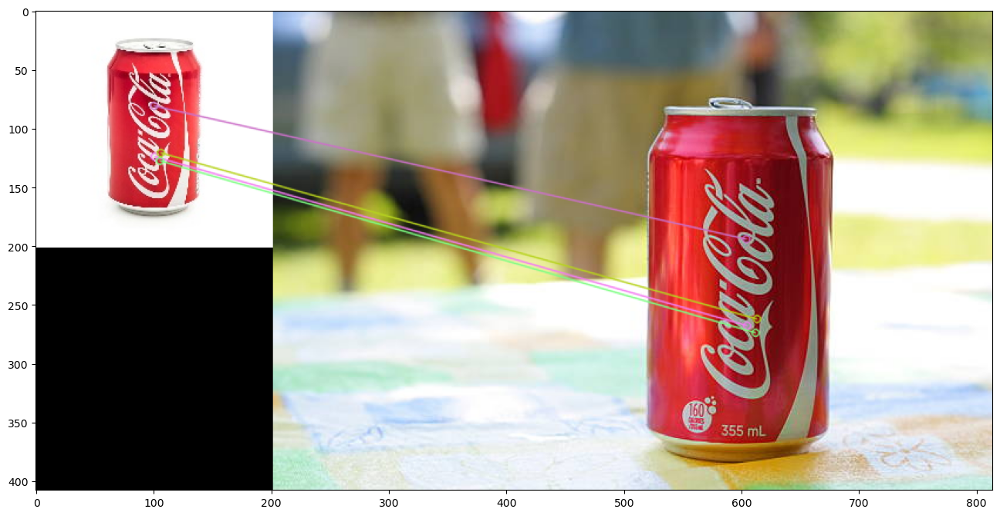

In [16]:
matches_filtered = []

for m in matches:
    if m.distance < 150:
        matches_filtered.append(m)

img_matches_filtered = cv2.drawMatches(coke, k1, table, k2, matches_filtered, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(16, 10))

plt.imshow(img_matches_filtered[..., ::-1])

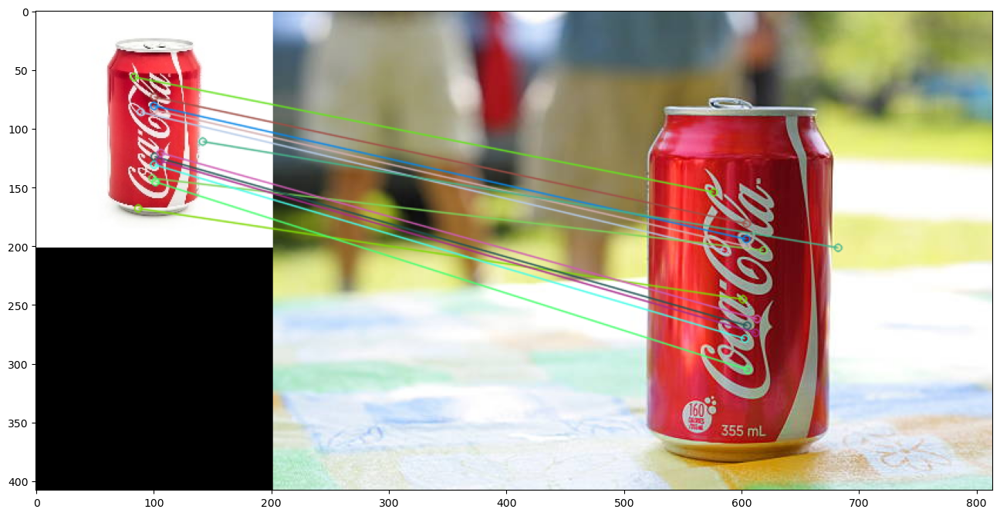

In [17]:
matches_filtered = []

for m in matches:
    if m.distance < 200:
        matches_filtered.append(m)

img_matches_filtered = cv2.drawMatches(coke, k1, table, k2, matches_filtered, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(16, 10))

plt.imshow(img_matches_filtered[..., ::-1])

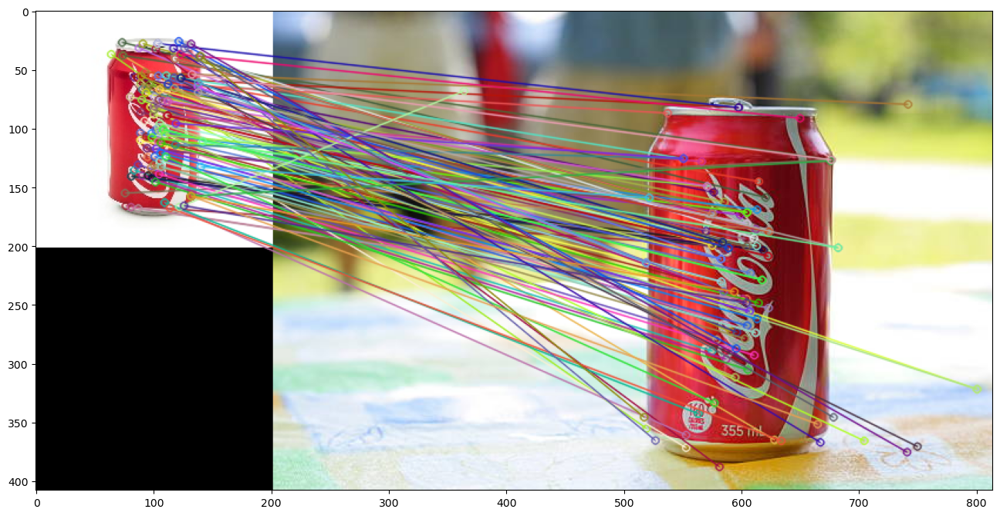

In [18]:
flann = cv2.FlannBasedMatcher_create()
matches = flann.match(ds1, ds2)

img_matches = cv2.drawMatches(coke, k1, table, k2, matches, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(16, 10))
plt.imshow(img_matches[..., ::-1])

##### Zadanie 3b

Znajdź transformację geometryczną dla par dopasowanych punktów, tak aby przekształcić `coke` (_train_) do geometrii `table` (_query_). Zademonstruj poprawność, zestawiając obok siebie przekształconą wersję `coke` oraz oryginalny `table`, bądź nanosząc jedno na drugie. Zidentyfikuj punkty, które znaleziona transformacja przekształca "dobrze", tzn. ich współrzędne po przekształceniu leżą w pobliżu odpowiadających im punktów z drugiego obrazu; nanieś je na obraz.

*Jak na wyniki wpływa wykrycie większej lub mniejszej liczby punktów kluczowych na etapie SIFT? W jakim stopniu filtracja poprawia rezultaty? Jak działa i jaką rolę w procesie parowania odgrywa RANSAC?*

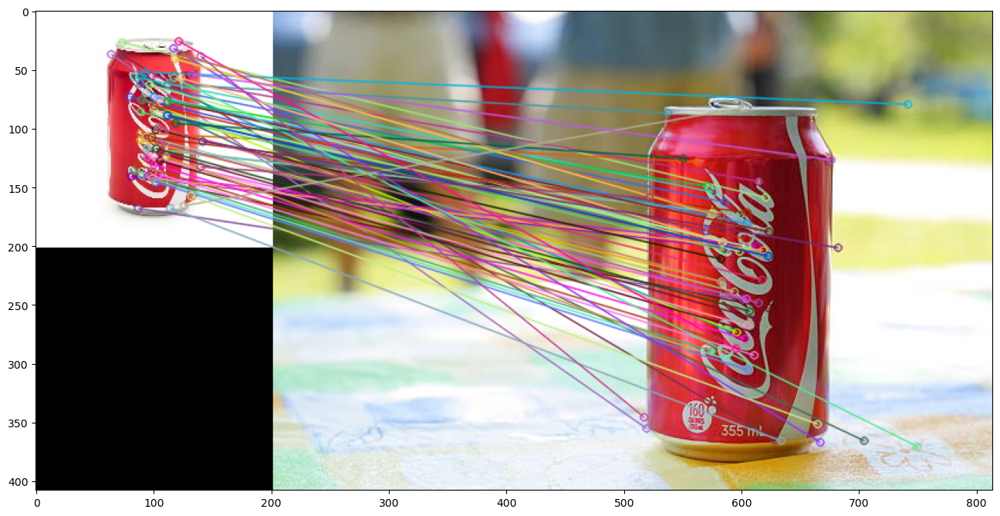

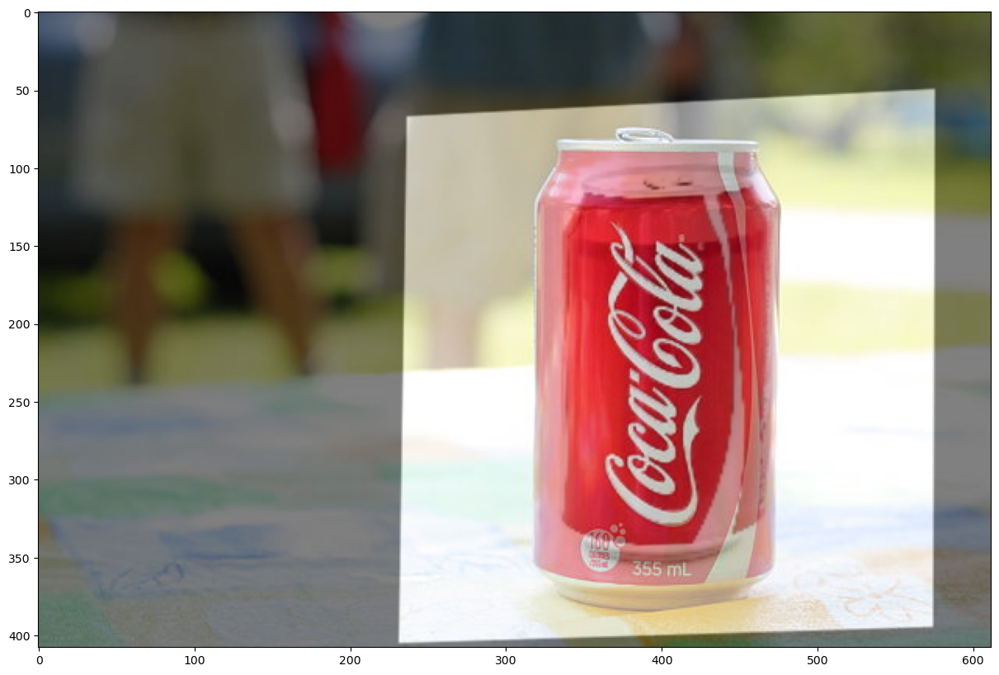

In [19]:
sift = cv2.SIFT_create()

k1, ds1 = sift.detectAndCompute(coke, None)
k2, ds2 = sift.detectAndCompute(table, None)

flann = cv2.BFMatcher_create(cv2.NORM_L2, crossCheck=True)

matches = flann.match(ds1, ds2)

img_matches = cv2.drawMatches(coke, k1, table, k2, matches, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(16, 10))

plt.imshow(img_matches[..., ::-1])
plt.show()

train = np.array([k1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2).astype(np.float32)
query = np.array([k2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2).astype(np.float32)

H, _ = cv2.findHomography(train, query, cv2.RANSAC, 5.0)

coke_warped = cv2.warpPerspective(coke, H, (table.shape[1], table.shape[0]))

plt.figure(figsize=(16, 10))

plt.imshow(cv2.addWeighted(table, 0.5, coke_warped, 0.5, 0)[..., ::-1])
plt.show()

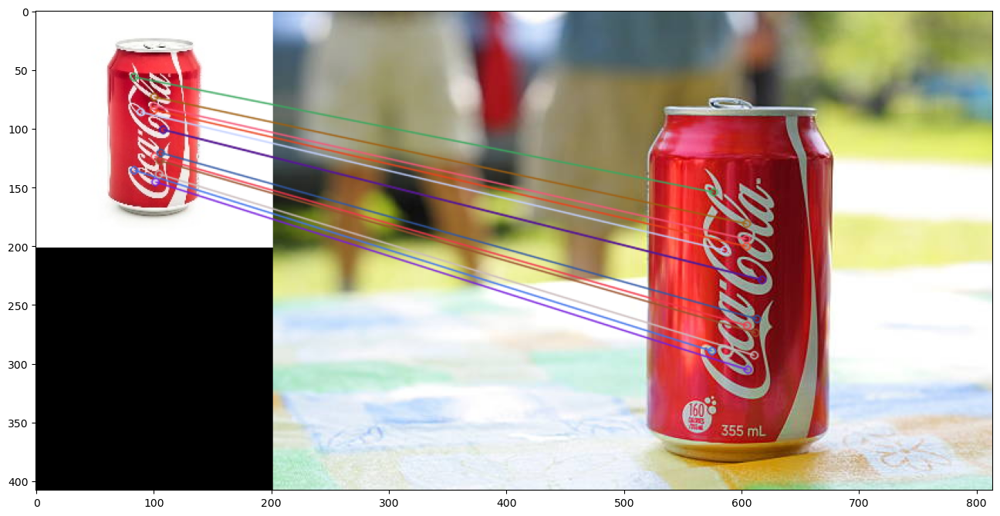

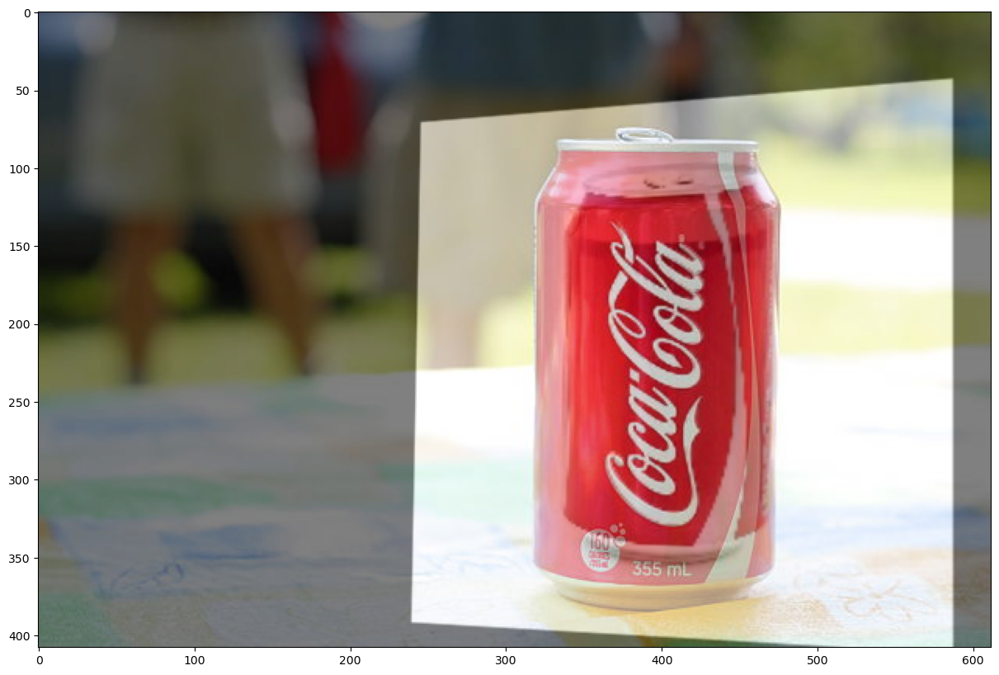

In [25]:
knn_matcher = cv2.BFMatcher_create(cv2.NORM_L2, crossCheck=False)

matches = knn_matcher.knnMatch(ds1, ds2, k=2)

good_matches = []
for m, n in matches:
    if m.distance < 0.6 * n.distance:
        good_matches.append(m)

img_matches = cv2.drawMatches(coke, k1, table, k2, good_matches, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(16, 10))

plt.imshow(img_matches[..., ::-1])
plt.show()

train = np.array([k1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2).astype(np.float32)
query = np.array([k2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2).astype(np.float32)

H, _ = cv2.findHomography(train, query, cv2.RANSAC, 5.0)

coke_warped = cv2.warpPerspective(coke, H, (table.shape[1], table.shape[0]))

plt.figure(figsize=(16, 10))

plt.imshow(cv2.addWeighted(table, 0.5, coke_warped, 0.5, 0)[..., ::-1])

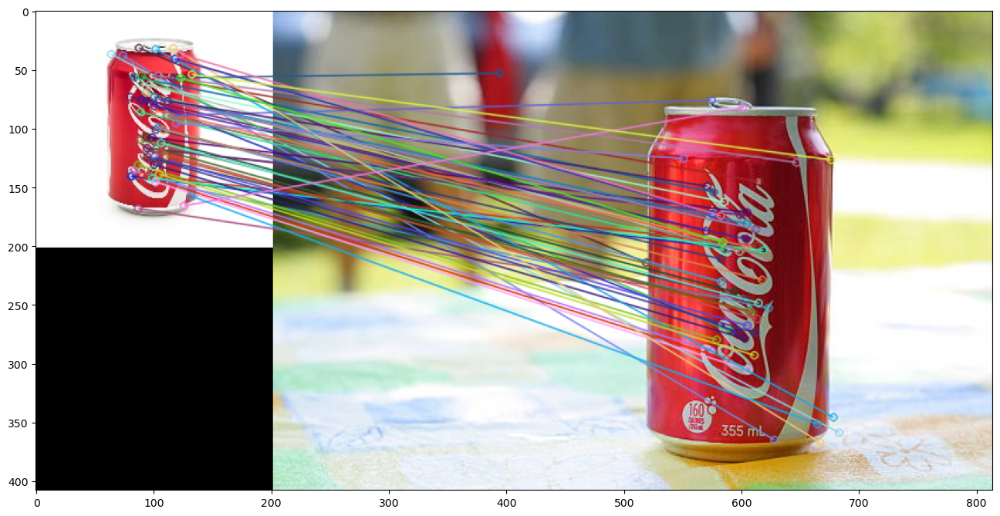

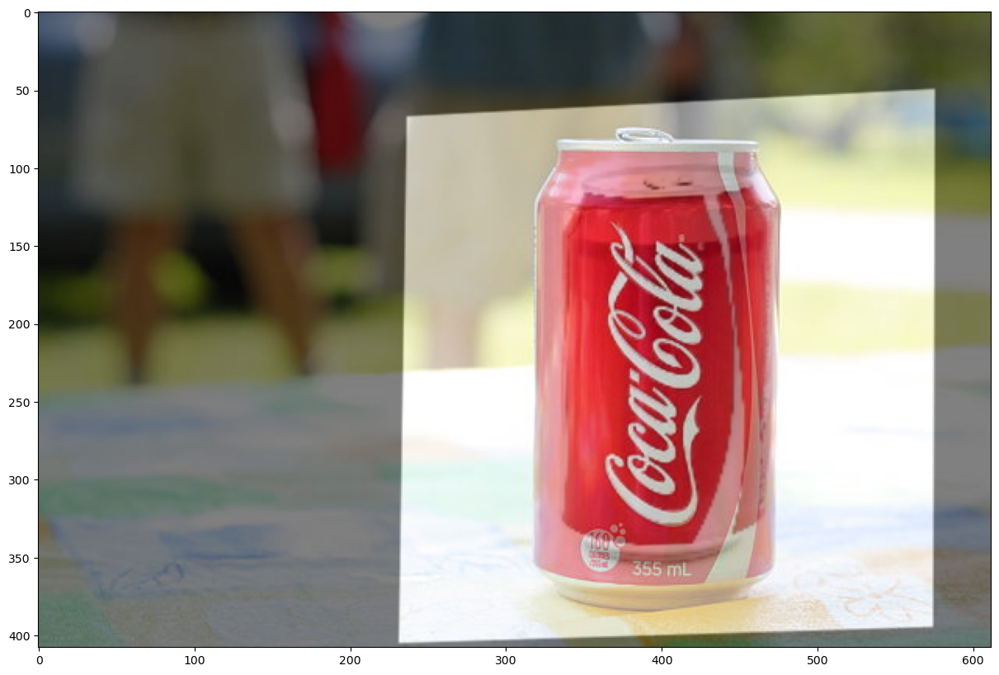

In [21]:
sift = cv2.SIFT_create(contrastThreshold=0.07, edgeThreshold=10)

k1, ds1 = sift.detectAndCompute(coke, None)
k2, ds2 = sift.detectAndCompute(table, None)

flann = cv2.BFMatcher_create(cv2.NORM_L2, crossCheck=True)

matches = flann.match(ds1, ds2)

img_matches = cv2.drawMatches(coke, k1, table, k2, matches, None, flags=cv2.DRAW_MATCHES_FLAGS_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(16, 10))

plt.imshow(img_matches[..., ::-1])
plt.show()

train = np.array([k1[m.queryIdx].pt for m in matches]).reshape(-1, 1, 2).astype(np.float32)
query = np.array([k2[m.trainIdx].pt for m in matches]).reshape(-1, 1, 2).astype(np.float32)

H, _ = cv2.findHomography(train, query, cv2.RANSAC, 5.0)

coke_warped = cv2.warpPerspective(coke, H, (table.shape[1], table.shape[0]))

plt.figure(figsize=(16, 10))

plt.imshow(cv2.addWeighted(table, 0.5, coke_warped, 0.5, 0)[..., ::-1])
plt.show()